# Spotify API for audio features and visualisation with Plot.ly
In part 1 of this project we have scraped the Spotify charts website (remember which doesn't provide programmatic access such as an API) and saved the daily charts (top 200 tracks) for all available countries. We recorded the title, artist, date, number of streams and a unique track-ID. We will use this track-ID to join additional audio features which are available only via the Spotify API. You will need developer credentials but don't need a premium Spotify account.<br>
<br>
Requirements:
- spotipy library (via pip/sudo easy_install)
- Spotify developer credentials (client ID, client secret) and free or premium account
- Plot.ly account and API credentials

Ressources:
- https://developer.spotify.com/documentation/web-api/quick-start/
- https://bit.ly/33hkQzN (dataset for German top 200 charts from last three years on daily basis)

In [ ]:
import pandas as pd
de_charts = pd.read_csv('https://bit.ly/33hkQzN')

In [2]:
del de_charts['Unnamed: 0']

In [3]:
len(de_charts['Track_ID'].unique())

5052

We can see that Germany's top 200 charts were dominated by 5052 individual tracks over the past three years.

In [5]:
de_charts.head() # 5 most recent observations

,Rank,Title_Artist,Streams,Track_URL,Track_ID,Track title,Artist,country_code,date
0,1,110 by Capital Bra,1114778,https://open.spotify.com/track/5sdQ7VUx6GOfsRo...,5sdQ7VUx6GOfsRoSxnK1YG,110,Capital Bra,DE,2019-10-02
1,2,Roller by Apache 207,1085615,https://open.spotify.com/track/5dhQeuLGmlhfwlI...,5dhQeuLGmlhfwlI6BWfSpo,Roller,Apache 207,DE,2019-10-02
2,3,200 km/h by Apache 207,935756,https://open.spotify.com/track/2wvLtM25eMpHK7h...,2wvLtM25eMpHK7hkidqte2,200 km/h,Apache 207,DE,2019-10-02
3,4,Dance Monkey by Tones and I,843806,https://open.spotify.com/track/1rgnBhdG2JDFTbY...,1rgnBhdG2JDFTbYkYRZAku,Dance Monkey,Tones and I,DE,2019-10-02
4,5,Honda Civic by The Cratez,793061,https://open.spotify.com/track/0WFgtxiLNr99Yao...,0WFgtxiLNr99YaoSdYR3Ud,Honda Civic,The Cratez,DE,2019-10-02


In [6]:
unique_tracks = de_charts.groupby('Track_ID').sum()
unique_tracks.reset_index(inplace = True, drop = False)

In [7]:
unique_tracks.sort_values('Streams', ascending=False).head()

,Track_ID,Rank,Streams
4946,7qiZfU4dY1lWllzX7mPBI3,51234,123161170
172,0E9ZjEAyAwOXZ7wJC0PD33,22605,105546467
69,05Mp2UJulSttxQ4E6hQPH3,91682,85258371
1352,25sgk305KZfyuqVBQIahim,19238,75347510
2900,4UOXo3xWnxYdTf3sFyRaUG,15061,70063534


Wow, the song with Track_ID '7qiZfU4dY1lWllzX7mPBI3' was played more than 123 millions times whenever it made it into the top 200 over the past three years in Germany! (Of course the song was probably streamed many times outside of the top 200...)<br>
But which song is it?

In [8]:
sub_df = de_charts[de_charts['Track_ID'] == '7qiZfU4dY1lWllzX7mPBI3']

date = list(sub_df['date'].values)
streams = list(sub_df['Streams'].values)

top_df = pd.DataFrame({'Date' : date, 'Streams' : streams})
top_df['Date'] = pd.to_datetime(top_df['Date'])
top_df.set_index('Date', inplace=True)

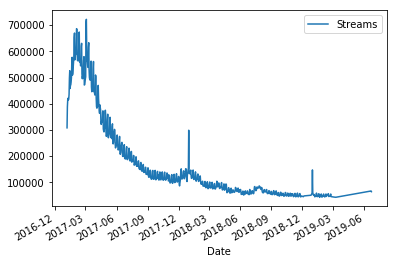

In [10]:
% matplotlib inline
top_df.plot()

Looks like a real hype song, peaking shortly after publication but (relatively) loosing popularity as quickly and stabilizing at around 100k streams per day now.

We want to know more about this track's characteristics and maybe figure out which song it is. Therefore, let's connect to the Spotify API.

In [ ]:
import spotipy
import spotipy.oauth2 as oauth2

CLIENT_ID = "ENTER YOUR CLIENT_ID HERE"
CLIENT_SECRET = "ENTER YOUR CLIENT_SECRET HERE"

credentials = oauth2.SpotifyClientCredentials(
        client_id=CLIENT_ID,
        client_secret=CLIENT_SECRET)

spotify = spotipy.Spotify(client_credentials_manager=credentials)

In [13]:
spotify.audio_features('7qiZfU4dY1lWllzX7mPBI3')

[{'danceability': 0.825,
  'energy': 0.652,
  'key': 1,
  'loudness': -3.183,
  'mode': 0,
  'speechiness': 0.0802,
  'acousticness': 0.581,
  'instrumentalness': 0,
  'liveness': 0.0931,
  'valence': 0.931,
  'tempo': 95.977,
  'type': 'audio_features',
  'id': '7qiZfU4dY1lWllzX7mPBI3',
  'uri': 'spotify:track:7qiZfU4dY1lWllzX7mPBI3',
  'track_href': 'https://api.spotify.com/v1/tracks/7qiZfU4dY1lWllzX7mPBI3',
  'analysis_url': 'https://api.spotify.com/v1/audio-analysis/7qiZfU4dY1lWllzX7mPBI3',
  'duration_ms': 233713,
  'time_signature': 4}]

So it seems this number 1 hit is pretty danceable, has a decent amount of energy, is not instrumental at all and unclear whether acoustic or not.

Time to unveil the secret. Let's listen to it!

In [17]:
from IPython.display import Audio
Audio(url=spotify.track('7qiZfU4dY1lWllzX7mPBI3')['preview_url'] + '.mp3')

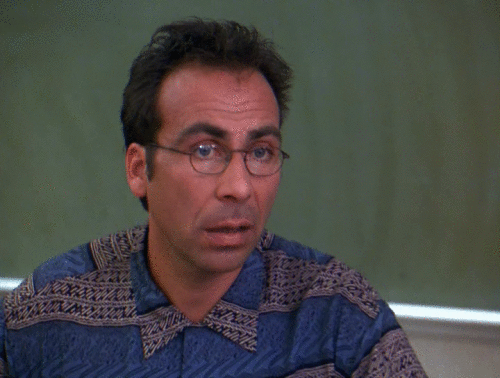

In [19]:
from IPython.display import Image
Image("https://media.giphy.com/media/sjDV6YTbw8tig/source.gif")

In [21]:
spotify.track('7qiZfU4dY1lWllzX7mPBI3').keys()

dict_keys(['album', 'artists', 'available_markets', 'disc_number', 'duration_ms', 'explicit', 'external_ids', 'external_urls', 'href', 'id', 'is_local', 'name', 'popularity', 'preview_url', 'track_number', 'type', 'uri'])

Uncomment the cell below to verify that you have recognised the song (I'm sure you have ;-))

In [ ]:
# print(spotify.track('7qiZfU4dY1lWllzX7mPBI3')['name'])
# print(spotify.track('7qiZfU4dY1lWllzX7mPBI3')['artists'][0]['name'])

Now I'm retrieving audio features for the entire dataset of Track_IDs. If you query too many at once you'll get an error so make sure to split your query into batches of e.g. size 100 (must be below 200 for Spotify queries).

In [33]:
# Split the Track_IDs into batches of size 100

part_list = []

for bunch in range(0, len(de_charts['Track_ID'].unique()), 100):
    
    part = de_charts['Track_ID'].unique()[bunch:bunch+100]
    
    part_list.append(part)

In [37]:
# Send the actual request for audio features by spotify.audio_features and supply a list containing track_ids as argument
# Build in a break of a half second after each query

import time

df_list = []

for idx, bunch in enumerate(part_list):
    
    print("Scraping bunch " + str(idx) + ', remaining: ' + str(len(part_list)-idx))
    
    sub = spotify.audio_features(bunch)
    sub_df = pd.DataFrame(sub)
    df_list.append(sub_df)
      
    time.sleep(0.5)

Scraping bunch 0, remaining: 51
Scraping bunch 1, remaining: 50
Scraping bunch 2, remaining: 49
Scraping bunch 3, remaining: 48
Scraping bunch 4, remaining: 47
Scraping bunch 5, remaining: 46
Scraping bunch 6, remaining: 45
Scraping bunch 7, remaining: 44
Scraping bunch 8, remaining: 43
Scraping bunch 9, remaining: 42
Scraping bunch 10, remaining: 41
Scraping bunch 11, remaining: 40
Scraping bunch 12, remaining: 39
Scraping bunch 13, remaining: 38
Scraping bunch 14, remaining: 37
Scraping bunch 15, remaining: 36
Scraping bunch 16, remaining: 35
Scraping bunch 17, remaining: 34
Scraping bunch 18, remaining: 33
Scraping bunch 19, remaining: 32
Scraping bunch 20, remaining: 31
Scraping bunch 21, remaining: 30
Scraping bunch 22, remaining: 29
Scraping bunch 23, remaining: 28
Scraping bunch 24, remaining: 27
Scraping bunch 25, remaining: 26
Scraping bunch 26, remaining: 25
Scraping bunch 27, remaining: 24
Scraping bunch 28, remaining: 23
Scraping bunch 29, remaining: 22
Scraping bunch 30, r

In [38]:
audio_features_df = pd.concat(df_list)
audio_features_df.head()

,acousticness,analysis_url,danceability,duration_ms,energy,id,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,time_signature,track_href,type,uri,valence
0,0.533,https://api.spotify.com/v1/audio-analysis/5sdQ...,0.480,194534,0.749,5sdQ7VUx6GOfsRoSxnK1YG,0.000000,1,0.0997,-5.057,0,0.4320,179.056,4,https://api.spotify.com/v1/tracks/5sdQ7VUx6GOf...,audio_features,spotify:track:5sdQ7VUx6GOfsRoSxnK1YG,0.419
1,0.030,https://api.spotify.com/v1/audio-analysis/5dhQ...,0.928,158853,0.758,5dhQeuLGmlhfwlI6BWfSpo,0.004370,10,0.2900,-6.471,0,0.1440,128.005,4,https://api.spotify.com/v1/tracks/5dhQeuLGmlhf...,audio_features,spotify:track:5dhQeuLGmlhfwlI6BWfSpo,0.729
2,0.273,https://api.spotify.com/v1/audio-analysis/2wvL...,0.904,164080,0.677,2wvLtM25eMpHK7hkidqte2,0.000016,11,0.1060,-6.413,0,0.1770,148.049,4,https://api.spotify.com/v1/tracks/2wvLtM25eMpH...,audio_features,spotify:track:2wvLtM25eMpHK7hkidqte2,0.424
3,0.688,https://api.spotify.com/v1/audio-analysis/1rgn...,0.825,209755,0.593,1rgnBhdG2JDFTbYkYRZAku,0.000161,6,0.1700,-6.401,0,0.0988,98.078,4,https://api.spotify.com/v1/tracks/1rgnBhdG2JDF...,audio_features,spotify:track:1rgnBhdG2JDFTbYkYRZAku,0.540
4,0.282,https://api.spotify.com/v1/audio-analysis/0WFg...,0.704,158061,0.782,0WFgtxiLNr99YaoSdYR3Ud,0.007690,1,0.0759,-5.471,0,0.1640,93.350,4,https://api.spotify.com/v1/tracks/0WFgtxiLNr99...,audio_features,spotify:track:0WFgtxiLNr99YaoSdYR3Ud,0.346


In the cell below I combine the information from the Spotify charts dataset with the audio features from the Spotify API.

In [39]:
final_df = unique_tracks.merge(audio_features_df, how = 'left', left_on='Track_ID', right_on = 'id')

Let's try to identify predictors for popularity of tracks (measured by absolute streaming count) on Spotify by running a linear regression.

In [40]:
import statsmodels.api as sm

X = final_df[['acousticness', 'danceability', 'duration_ms', 'energy', 'instrumentalness', 'loudness', 'tempo']]
Y = final_df['Streams']

X = sm.add_constant(X) # adding a constant
model = sm.OLS(Y, X).fit()
print_model = model.summary()
print(print_model)

                            OLS Regression Results                            
Dep. Variable:                Streams   R-squared:                       0.015
Model:                            OLS   Adj. R-squared:                  0.014
Method:                 Least Squares   F-statistic:                     11.23
Date:                Thu, 10 Oct 2019   Prob (F-statistic):           3.48e-14
Time:                        13:35:27   Log-Likelihood:                -87732.
No. Observations:                5052   AIC:                         1.755e+05
Df Residuals:                    5044   BIC:                         1.755e+05
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const             4.402e+06    1.6e+06  

Interesting! It seems that 'danceability' and 'loudness' are strong predictors for popularity.

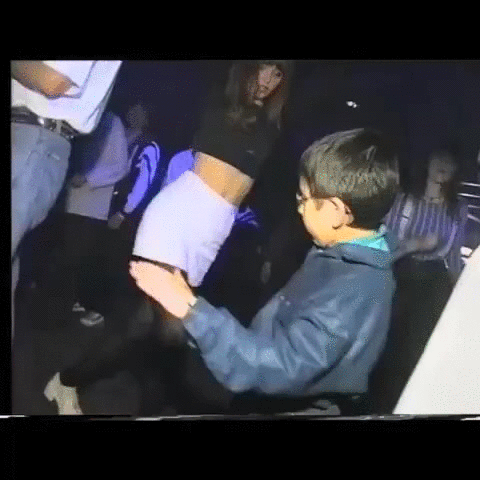

In [41]:
from IPython.display import Image
Image("https://media.giphy.com/media/TfKfqjt2i4GIM/giphy.gif")

## Visualisation with Plot.ly
Finally I want to visualise the evolution of streams of the overall top 3 tracks for Germany but not in a generic, boring matplotlib and ggplot style. Plot.ly is a pretty cool open source tool that allows you to create your graphs from scratch, gives you full control over graph elements and provides any kind of interactivity for different chart types. Every time you generate a new plot it will be pushed to your (public) Plot.ly account and you can share the graphs with others.

In [42]:
import plotly
import plotly.plotly as py
import plotly.graph_objs as go
plotly.tools.set_credentials_file(username='ENTER YOUR USERNAME HERE', api_key='ENTER YOUR API_KEY HERE')

In [43]:
second_df = de_charts[de_charts['Track_ID'] == '0E9ZjEAyAwOXZ7wJC0PD33']

date = list(second_df['date'].values)
streams = list(second_df['Streams'].values)

second_df = pd.DataFrame({'Date' : date, 'Streams' : streams})
second_df['Date'] = pd.to_datetime(second_df['Date'])
second_df.set_index('Date', inplace=True)

third_df = de_charts[de_charts['Track_ID'] == '05Mp2UJulSttxQ4E6hQPH3']

date = list(third_df['date'].values)
streams = list(third_df['Streams'].values)

third_df = pd.DataFrame({'Date' : date, 'Streams' : streams})
third_df['Date'] = pd.to_datetime(third_df['Date'])
third_df.set_index('Date', inplace=True)

In [44]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(x=list(top_df.index), y=list(top_df['Streams'])))

fig.add_trace(
    go.Scatter(x=list(second_df.index), y=list(second_df['Streams'])))

fig.add_trace(
    go.Scatter(x=list(third_df.index), y=list(third_df['Streams'])))

fig.layout.update(
    xaxis=go.layout.XAxis(
        rangeselector=dict(
            buttons=list([
                dict(count=1,
                     label="1m",
                     step="month",
                     stepmode="backward"),
                dict(count=6,
                     label="6m",
                     step="month",
                     stepmode="backward"),
                dict(count=1,
                     label="YTD",
                     step="year",
                     stepmode="todate"),
                dict(count=1,
                     label="1y",
                     step="year",
                     stepmode="backward"),
                dict(step="all")
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

py.iplot(fig, filename = 'top-spotify')

This analysis concludes the Python workshop on webscraping of EU Code Week 2019. We have covered a lot of concepts in terms of programming but also on how programmatic communication in times of the internet and big data works. The Spotify project has taught me what kind of behaviour 'hype' songs show and how we can explain popularity of streams on Spotify. There are many more applications that are waiting for you to explore the possibilities novel datasets and access offer to you. Stay curious and start exploring, learn new skills by tackling specific projects and pass on your knowledge just as I did it with you on the 9th of October 2019 in Berlin!